# What drives the price of a car?

![](images/kurt.jpeg)

**OVERVIEW**

In this application, you will explore a dataset from kaggle. The original dataset contained information on 3 million used cars. The provided dataset contains information on 426K cars to ensure speed of processing.  Your goal is to understand what factors make a car more or less expensive.  As a result of your analysis, you should provide clear recommendations to your client -- a used car dealership -- as to what consumers value in a used car.

### CRISP-DM Framework

<center>
    <img src = images/crisp.png width = 50%/>
</center>


To frame the task, throughout our practical applications we will refer back to a standard process in industry for data projects called CRISP-DM.  This process provides a framework for working through a data problem.  Your first step in this application will be to read through a brief overview of CRISP-DM [here](https://mo-pcco.s3.us-east-1.amazonaws.com/BH-PCMLAI/module_11/readings_starter.zip).  After reading the overview, answer the questions below.

### Business Understanding

From a business perspective, we are tasked with identifying key drivers for used car prices.  In the CRISP-DM overview, we are asked to convert this business framing to a data problem definition.  Using a few sentences, reframe the task as a data task with the appropriate technical vocabulary. 

###### Business Goals and Objective - 

To provide the best prediction of what attributes/features do customers value in a used car. 

##### Project Plan -

Use Data processing models and validation techniques such as Linear Regression analysis, Grid SearchCV, Ridge/Lasso CV analysis to gain insights into identifying the most optimal feature-set (relatively small MSE). 


##### Data Mining Goals and Business Success Criteria -

Gain insights into the key feature-set that determines the price of a used car. \
Build a prediction model that has 75% accuracy





### Data Understanding

After considering the business understanding, we want to get familiar with our data.  Write down some steps that you would take to get to know the dataset and identify any quality issues within.  Take time to get to know the dataset and explore what information it contains and how this could be used to inform your business understanding.

In [1]:
#Imporing Libraries
import pandas as pd
import seaborn as sns
import numpy as np
import datetime
import matplotlib
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge
from sklearn.preprocessing import StandardScaler, Normalizer
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.feature_selection import SequentialFeatureSelector
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_squared_error, mean_absolute_error,  r2_score

In [2]:
# Load the data
car = pd.read_csv('Downloads/vehicles.csv')

In [3]:
# Exploring the data, lets start by describing the dataframe to get a list of provided attributes/features
car.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 18 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            426880 non-null  int64  
 1   region        426880 non-null  object 
 2   price         426880 non-null  int64  
 3   year          425675 non-null  float64
 4   manufacturer  409234 non-null  object 
 5   model         421603 non-null  object 
 6   condition     252776 non-null  object 
 7   cylinders     249202 non-null  object 
 8   fuel          423867 non-null  object 
 9   odometer      422480 non-null  float64
 10  title_status  418638 non-null  object 
 11  transmission  424324 non-null  object 
 12  VIN           265838 non-null  object 
 13  drive         296313 non-null  object 
 14  size          120519 non-null  object 
 15  type          334022 non-null  object 
 16  paint_color   296677 non-null  object 
 17  state         426880 non-null  object 
dtypes: f

In [4]:
car.head()

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
0,7222695916,prescott,6000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,az
1,7218891961,fayetteville,11900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ar
2,7221797935,florida keys,21000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,fl
3,7222270760,worcester / central MA,1500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ma
4,7210384030,greensboro,4900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nc


Investigate the dataset for missing or problematic data.

In [5]:
# Identify where there is Missing data
missing_values = car.isnull().sum()
#print(missing_values[missing_values > 0].index.tolist())
print(missing_values)

id                   0
region               0
price                0
year              1205
manufacturer     17646
model             5277
condition       174104
cylinders       177678
fuel              3013
odometer          4400
title_status      8242
transmission      2556
VIN             161042
drive           130567
size            306361
type             92858
paint_color     130203
state                0
dtype: int64


In [6]:
#Explore Object dtype columns to identify any problematic data on irrelevant attributes/features
for i in car.select_dtypes('object').columns:
    print(i, car[i].unique())

region ['prescott' 'fayetteville' 'florida keys' 'worcester / central MA'
 'greensboro' 'hudson valley' 'medford-ashland' 'erie' 'el paso'
 'bellingham' 'skagit / island / SJI' 'la crosse' 'auburn' 'birmingham'
 'dothan' 'florence / muscle shoals' 'gadsden-anniston'
 'huntsville / decatur' 'mobile' 'montgomery' 'tuscaloosa'
 'anchorage / mat-su' 'fairbanks' 'kenai peninsula' 'southeast alaska'
 'flagstaff / sedona' 'mohave county' 'phoenix' 'show low' 'sierra vista'
 'tucson' 'yuma' 'fort smith' 'jonesboro' 'little rock' 'texarkana'
 'bakersfield' 'chico' 'fresno / madera' 'gold country' 'hanford-corcoran'
 'humboldt county' 'imperial county' 'inland empire' 'los angeles'
 'mendocino county' 'merced' 'modesto' 'monterey bay' 'orange county'
 'palm springs' 'redding' 'reno / tahoe' 'sacramento' 'san diego'
 'san luis obispo' 'santa barbara' 'santa maria' 'SF bay area'
 'siskiyou county' 'stockton' 'susanville' 'ventura county'
 'visalia-tulare' 'yuba-sutter' 'boulder' 'colorado springs'

In [7]:
#Explore int dtype columns to identify any problematic data on irrelevant attributes/features
for i in car.select_dtypes('int').columns:
    print(i, car[i].unique())

id [7222695916 7218891961 7221797935 ... 7301591147 7301591140 7301591129]
price [ 6000 11900 21000 ...  6328 19853 17873]


In [8]:
for i in car.select_dtypes('float').columns:
    print(i, car[i].unique())

year [  nan 2014. 2010. 2020. 2017. 2013. 2012. 2016. 2019. 2011. 1992. 2018.
 2004. 2015. 2001. 2006. 1968. 2003. 2008. 2007. 2005. 1966. 2009. 1998.
 2002. 1999. 2021. 1997. 1976. 1969. 1995. 1978. 1954. 1979. 1970. 1974.
 1996. 1987. 2000. 1955. 1960. 1991. 1972. 1988. 1994. 1929. 1984. 1986.
 1989. 1973. 1946. 1933. 1958. 1937. 1985. 1957. 1953. 1942. 1963. 1977.
 1993. 1903. 1990. 1965. 1982. 1948. 1983. 1936. 1932. 1951. 1931. 1980.
 1967. 1971. 1947. 1981. 1926. 1962. 1975. 1964. 1934. 1952. 1940. 1959.
 1950. 1930. 1956. 1922. 1928. 2022. 1901. 1941. 1924. 1927. 1939. 1923.
 1949. 1961. 1935. 1918. 1900. 1938. 1913. 1916. 1943. 1925. 1921. 1915.
 1945. 1902. 1905. 1920. 1944. 1910. 1909.]
odometer [    nan  57923.  71229. ... 172511.  94964.  26892.]


### Data Preparation

After our initial exploration and fine tuning of the business understanding, it is time to construct our final dataset prior to modeling.  Here, we want to make sure to handle any integrity issues and cleaning, the engineering of new features, any transformations that we believe should happen (scaling, logarithms, normalization, etc.), and general preparation for modeling with `sklearn`. 

In [9]:
# Drop irrelevant attributes and attributes that have null values
car.drop(['id', 'VIN','size','state','region','title_status'], axis =1, inplace = True)

In [10]:
# Replace the NaN values for categoric attributes
car['manufacturer'].fillna(value='other', inplace=True)
car['model'].fillna(value='other', inplace=True)

In [11]:
# filling missing values in drive and cylinder columns with  the most frequent value
car["drive"].fillna(car["drive"].mode()[0], inplace=True)
car["cylinders"].fillna(car["cylinders"].mode()[0], inplace=True)

In [12]:
# Drop duplicates
car = car.drop_duplicates(keep = 'first')

In [13]:
#perform label encoding on the categorical attributes to assign numeric mapping
from sklearn.preprocessing import LabelEncoder

car[['condition', 'cylinders', 'fuel','transmission','drive','type','paint_color']] = car[['condition', 'cylinders', 'fuel','transmission','drive','type','paint_color']].apply(LabelEncoder().fit_transform)
car.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 247867 entries, 0 to 426873
Data columns (total 12 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   price         247867 non-null  int64  
 1   year          247181 non-null  float64
 2   manufacturer  247867 non-null  object 
 3   model         247867 non-null  object 
 4   condition     247867 non-null  int32  
 5   cylinders     247867 non-null  int32  
 6   fuel          247867 non-null  int32  
 7   odometer      245342 non-null  float64
 8   transmission  247867 non-null  int32  
 9   drive         247867 non-null  int32  
 10  type          247867 non-null  int32  
 11  paint_color   247867 non-null  int32  
dtypes: float64(2), int32(7), int64(1), object(2)
memory usage: 18.0+ MB


In [14]:
# Identify outliers for Price
car['price'].describe()

count    2.478670e+05
mean     1.136106e+05
std      1.598699e+07
min      0.000000e+00
25%      4.900000e+03
50%      9.999000e+03
75%      1.997700e+04
max      3.736929e+09
Name: price, dtype: float64

In [15]:
import plotly.express as px
px.box(car, x="price")

In [16]:
# Identify outliers for Year
car['year'].describe()

count    247181.000000
mean       2009.423423
std          10.764288
min        1900.000000
25%        2006.000000
50%        2012.000000
75%        2016.000000
max        2022.000000
Name: year, dtype: float64

In [17]:
px.histogram(car, x= "year")

In [18]:
# Identify outliers for Odometer
car['odometer'].describe()

count    2.453420e+05
mean     1.123967e+05
std      2.510606e+05
min      0.000000e+00
25%      5.181600e+04
50%      9.968500e+04
75%      1.454798e+05
max      1.000000e+07
Name: odometer, dtype: float64

In [19]:
px.box(car, x="odometer")

In [20]:
# Remove outliers - #Use Quantiles to identify the upper and lower limits for Price, Year, and odometer

car = car[
        (car.year <= 2019) 
      & (car.year >= 2000)
      & (car.price <= 80000) 
      & (car.price >= 5000)
      & (car.odometer >= 5000) 
      & (car.odometer <= 300000)]

In [21]:
#Drop all remaining records that have null values
car = car.dropna()

In [22]:
# re-check if there are still any missing values
missing_values = car.isnull().sum()
print(missing_values)

price           0
year            0
manufacturer    0
model           0
condition       0
cylinders       0
fuel            0
odometer        0
transmission    0
drive           0
type            0
paint_color     0
dtype: int64


In [23]:
car.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 157195 entries, 27 to 426873
Data columns (total 12 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   price         157195 non-null  int64  
 1   year          157195 non-null  float64
 2   manufacturer  157195 non-null  object 
 3   model         157195 non-null  object 
 4   condition     157195 non-null  int32  
 5   cylinders     157195 non-null  int32  
 6   fuel          157195 non-null  int32  
 7   odometer      157195 non-null  float64
 8   transmission  157195 non-null  int32  
 9   drive         157195 non-null  int32  
 10  type          157195 non-null  int32  
 11  paint_color   157195 non-null  int32  
dtypes: float64(2), int32(7), int64(1), object(2)
memory usage: 11.4+ MB


### Modeling

With your (almost?) final dataset in hand, it is now time to build some models.  Here, you should build a number of different regression models with the price as the target.  In building your models, you should explore different parameters and be sure to cross-validate your findings.

In [24]:
#Check for correlation amongst the numeric values
car_corr = car.corr(numeric_only = True)
car_corr

,price,year,condition,cylinders,fuel,odometer,transmission,drive,type,paint_color
price,1.000000,0.513365,0.160233,0.244747,-0.160889,-0.468116,0.108948,-0.127859,0.002912,0.004744
year,0.513365,1.000000,0.160891,-0.153591,0.130417,-0.599091,0.108179,-0.040128,-0.034188,-0.023754
condition,0.160233,0.160891,1.000000,0.064613,0.047263,-0.101092,-0.033874,-0.122961,0.129526,0.110155
cylinders,0.244747,-0.153591,0.064613,1.000000,-0.074521,0.137164,0.026084,-0.102830,0.084982,0.080220
fuel,-0.160889,0.130417,0.047263,-0.074521,1.000000,-0.150464,0.137512,0.050161,-0.106410,-0.039180
odometer,-0.468116,-0.599091,-0.101092,0.137164,-0.150464,1.000000,-0.198732,-0.071536,0.064019,0.045107
transmission,0.108948,0.108179,-0.033874,0.026084,0.137512,-0.198732,1.000000,0.037961,-0.042744,-0.020049
drive,-0.127859,-0.040128,-0.122961,-0.102830,0.050161,-0.071536,0.037961,1.000000,-0.023119,-0.103824
type,0.002912,-0.034188,0.129526,0.084982,-0.106410,0.064019,-0.042744,-0.023119,1.000000,0.222190
paint_color,0.004744,-0.023754,0.110155,0.080220,-0.039180,0.045107,-0.020049,-0.103824,0.222190,1.000000


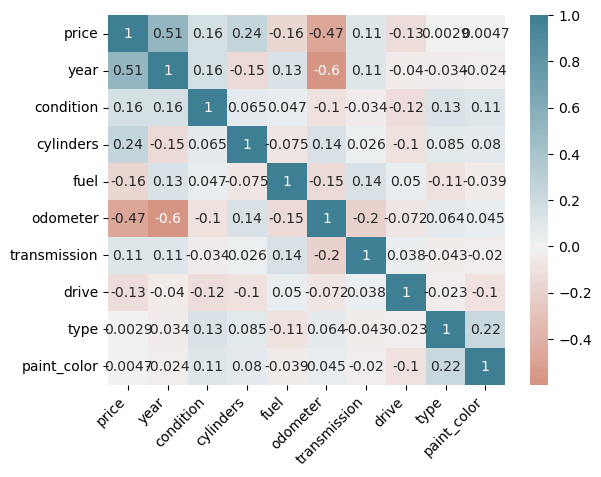

In [25]:
#Plot correlation matrix
ax = sns.heatmap(
 car_corr, annot=True,
    center=0,
    cmap=sns.diverging_palette(20, 220, n=200)
)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right'
);
plt.show()

## Strong positive correlation between Price and Year.The older the car, the lesser the price of the car and viceversa
## And, negative correlation between price and odometer. The higher the odometer, lower the price.

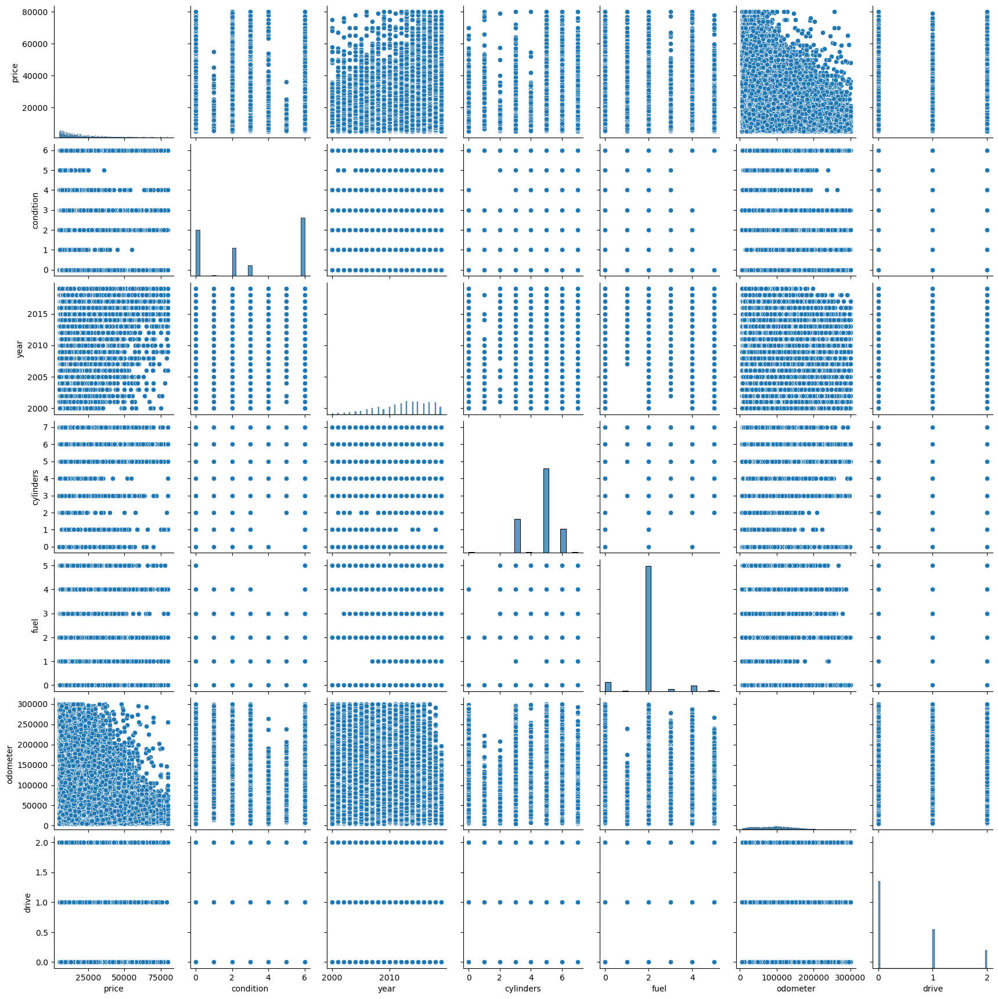

In [26]:
#Plot all numeric features that have shown considerable (positive/negative) correlation with price
feature_set = ["price", "condition", "year","cylinders","fuel","odometer","drive"]
sns.pairplot(car[feature_set])
plt.show();

<Axes: xlabel='price', ylabel='Count'>

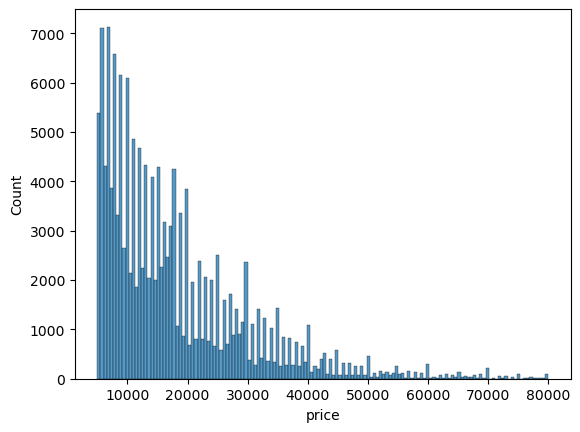

In [27]:
sns.histplot(car['price'])

<Axes: xlabel='price', ylabel='Count'>

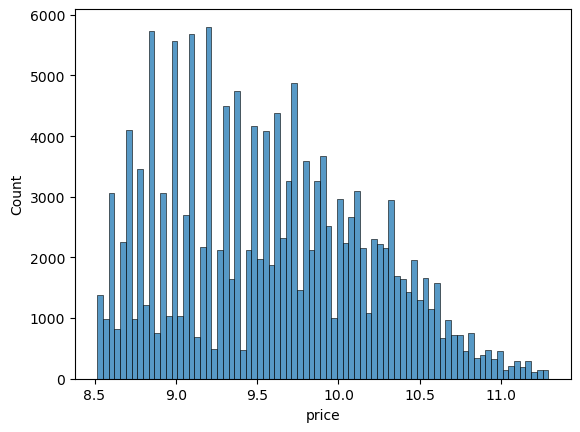

In [28]:
sns.histplot(np.log(car['price']))

#We also notice that the price is still heavily right skewed. So, we will use a log function to normalize the data

#### Exploratory Data Analysis

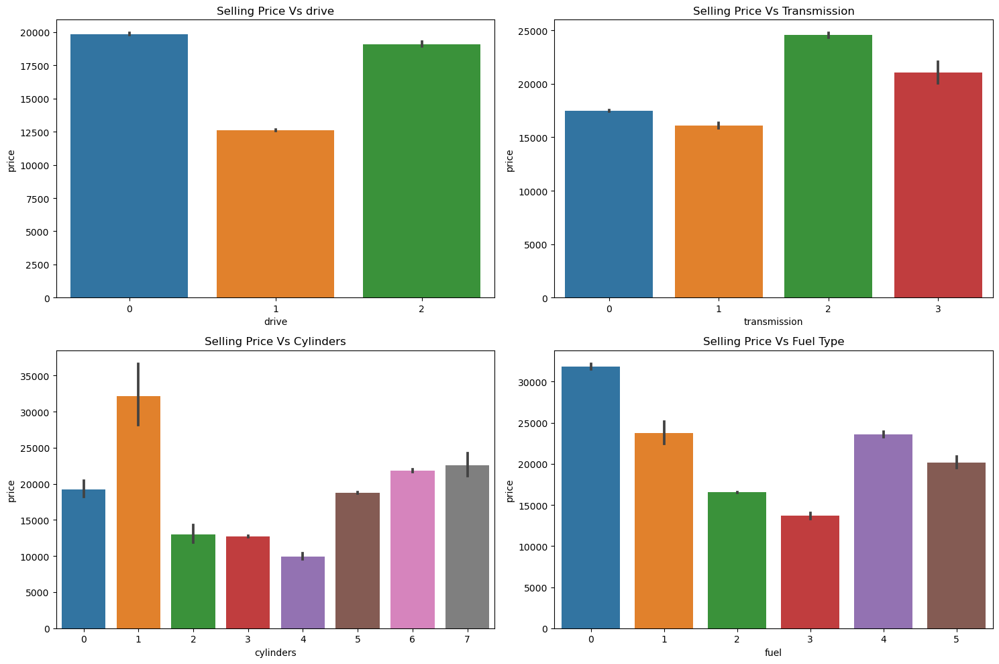

In [29]:
#Data visualization to understand the individual correlation between Price and other variables
plt.figure(figsize=(15,10))

plt.subplot(2,2,1)
sns.barplot(data=car,x='drive',y='price')
plt.title('Selling Price Vs drive')

plt.subplot(2,2,2)
sns.barplot(data=car,x='transmission',y='price')
plt.title('Selling Price Vs Transmission')

plt.subplot(2,2,3)
sns.barplot(data=car,x='cylinders',y='price')
plt.title('Selling Price Vs Cylinders')

plt.subplot(2,2,4)
sns.barplot(data=car,x='fuel',y='price')
plt.title('Selling Price Vs Fuel Type')

plt.tight_layout()
plt.show()


Observations -

Automatic transmission cars have higher sale price.
4wd drive cars have higher sale price
8 cylinder capacity cars have more sale price


Text(0.5, 1.0, 'Price by year of manf.')

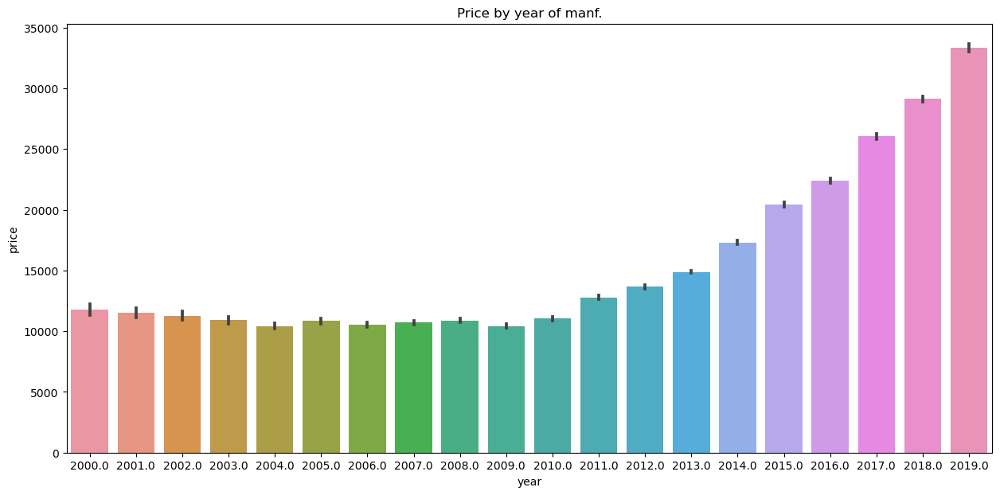

In [30]:
plt.figure(figsize=(15,7))
sns.barplot(data=car,x='year',y='price')
plt.title('Price by year of manf.')

Observations - Cars with year of manufacturing <5 years have higher sale price over cars that are much older.

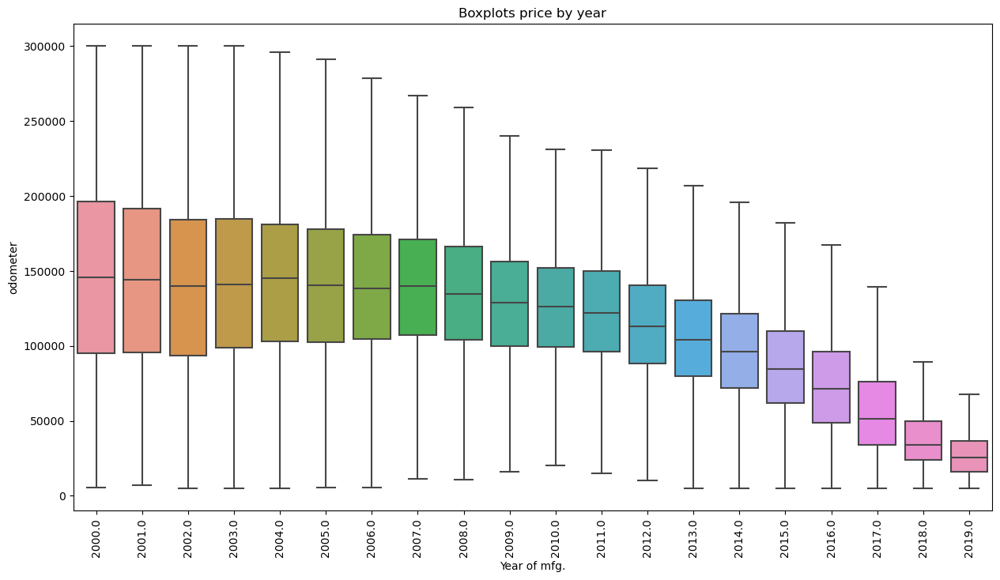

In [42]:
plt.figure(figsize=(15, 8))
sns.boxplot(x='year', y='odometer', data=car, showfliers=False)
plt.tick_params(axis='x', rotation=90)
plt.title('Boxplots price by year')
plt.xlabel('Year of mfg.')
plt.ylabel('odometer')
plt.show()

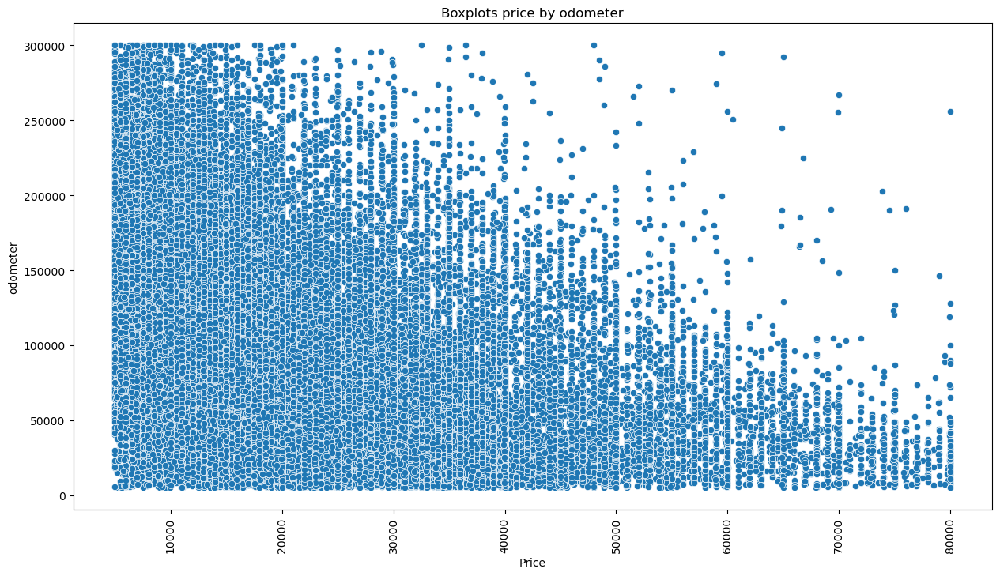

In [43]:
plt.figure(figsize=(15, 8))
sns.scatterplot(x='price', y='odometer', data=car)
plt.tick_params(axis='x', rotation=90)
plt.title('Boxplots price by odometer')
plt.xlabel('Price')
plt.ylabel('odometer')
plt.show()

In [32]:
#Train and test data sets to model the data
#We will use different regression models to identify the factors that determine the price of a car

X = car.drop(['price','manufacturer','model'], axis=1)
y = np.log(car.price)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=10)

In [33]:
#Write  a function to store the performance of the models into a dataframe

def result(y_test, y_pred):
    r=[]
    r.append('%.4f' % r2_score(y_test,y_pred))
    r.append('%.4f' % mean_squared_error(y_test, y_pred))
    r.append('%.4f' % mean_absolute_error(y_test, y_pred))
    r.append('%.4f' % np.sqrt(mean_squared_error(y_test, y_pred)))
    
    return (r)

score_data = pd.DataFrame(index=['R2 Score','Mean Squared Error', 'Mean Absolute Error', 'Root MSE'])

In [36]:
#Linear Regression Model 
from sklearn.pipeline import Pipeline

lr= LinearRegression()
lr.fit(X_train,y_train)
train_preds = lr.predict(X_train)
y_pred = lr.predict(X_test)

# #Append performance of model to the dataframe
score_lr = result(y_test, y_pred)
score_data['Linear Regression'] = score_lr
print('R2_score: ', score_lr[0])
print('Mean squared error: ', score_lr[1])
print('Mean absolute error: ', score_lr[2])
print('Root mean squared error: ', score_lr[3])

# selector_train_mse = mean_squared_error(y_train, train_preds)
# selector_test_mse = mean_squared_error(y_test, test_preds)
# print(f'Train MSE: {selector_train_mse}')
# print(f'Test MSE: {selector_test_mse}')
# print("RMSE score: {}".format(np.sqrt(mean_squared_error(test_preds, y_test))))
# print("R2_score with Ridge regression: {:.2f}".format(r2_score(test_preds, y_test)))

R2_score:  0.5486
Mean squared error:  0.1699
Mean absolute error:  0.3222
Root mean squared error:  0.4121


In [37]:
# Ridge CV using GridSearch

ridge_pipe = Pipeline([('selector', SequentialFeatureSelector(Ridge())),
                         ('model', Ridge())])
ridge_param_dict = {'selector__n_features_to_select': [2, 3, 4]}
ridge_grid = GridSearchCV(ridge_pipe, param_grid=ridge_param_dict)
ridge_grid.fit(X_train, y_train)
ridge_train_preds = ridge_grid.predict(X_train)
y_pred = ridge_grid.predict(X_test)

# #Append performance of model to the dataframe
score_rr = result(y_test, y_pred)
score_data['Ridge Regression'] = score_rr
print('R2 score: ', score_rr[0])
print('Mean squared error: ', score_rr[1])
print('Mean absolute error: ', score_rr[2])
print('Root mean squared error: ', score_rr[3])

# ridge_train_mse = mean_squared_error(y_train, ridge_train_preds)
# ridge_test_mse = mean_squared_error(y_test, ridge_test_preds)
# print(f'Ridge Train MSE: {ridge_train_mse}')
# print(f'Ridge Test MSE: {ridge_test_mse}')
# print("RMSE score: {}".format(np.sqrt(mean_squared_error(ridge_test_preds, y_test))))
# print("R2_score with Ridge regression: {:.2f}".format(r2_score(ridge_test_preds, y_test)))

R2 score:  0.5366
Mean squared error:  0.1744
Mean absolute error:  0.3269
Root mean squared error:  0.4176


In [38]:
#Lasso CV

lasso_pipe = Pipeline([('polyfeatures', PolynomialFeatures(degree = 3, include_bias = False)),
                      ('scaler', StandardScaler()),
                     ('lasso', Lasso(random_state = 42))])
lasso_pipe.fit(X_train, y_train)
lasso_coefs = lasso_pipe.named_steps['lasso'].coef_


lasso_pipe

Pipeline(steps=[('polyfeatures',
                 PolynomialFeatures(degree=3, include_bias=False)),
                ('scaler', StandardScaler()),
                ('lasso', Lasso(random_state=42))])

In [39]:
lasso_train_preds = lasso_pipe.predict(X_train)
y_pred = lasso_pipe.predict(X_test)

score_lasso = result(y_test, y_pred)
score_data['Lasso Regression'] = score_lasso
print('R2 score: ', score_lasso[0])
print('Mean squared error: ', score_lasso[1])
print('Mean absolute error: ', score_lasso[2])
print('Root mean squared error: ', score_lasso[3])

# lasso_train_mse = mean_squared_error(y_train, lasso_train_preds)
# lasso_test_mse = mean_squared_error(y_test, lasso_test_preds)

# print(f'Lasso Train MSE: {lasso_train_mse}')
# print(f'Lasso Test MSE: {lasso_test_mse}')
# print("RMSE score: {}".format(np.sqrt(mean_squared_error(lasso_test_preds, y_test))))

R2 score:  -0.0000
Mean squared error:  0.3763
Mean absolute error:  0.5132
Root mean squared error:  0.6134


### Evaluation

With some modeling accomplished, we aim to reflect on what we identify as a high quality model and what we are able to learn from this.  We should review our business objective and explore how well we can provide meaningful insight on drivers of used car prices.  Your goal now is to distill your findings and determine whether the earlier phases need revisitation and adjustment or if you have information of value to bring back to your client.

##### Model selection and Findings

In [40]:
score_data

,Linear Regression,Ridge Regression,Lasso Regression
R2 Score,0.5486,0.5366,-0.0000
Mean Squared Error,0.1699,0.1744,0.3763
Mean Absolute Error,0.3222,0.3269,0.5132
Root MSE,0.4121,0.4176,0.6134


In [41]:
best_estimator = ridge_grid.best_estimator_
best_selector = best_estimator.named_steps['selector']
best_model = ridge_grid.best_estimator_.named_steps['model']
feature_names = X_train.columns[best_selector.get_support()]
coefs = best_model.coef_

print(best_estimator)
print(f'Features from best selector: {feature_names}.')
print('Coefficient values: ')
print('===================')
pd.DataFrame([coefs.T], columns = feature_names, index = ['model'])

Pipeline(steps=[('selector',
                 SequentialFeatureSelector(estimator=Ridge(),
                                           n_features_to_select=4)),
                ('model', Ridge())])
Features from best selector: Index(['year', 'cylinders', 'fuel', 'odometer'], dtype='object').
Coefficient values: 


,year,cylinders,fuel,odometer
model,0.064091,0.203715,-0.169504,-0.000004


Based on the above model analysis, we notice that the Ridge Model has the least RMSE and highest R2 accuracy scores. So, I would recommend Ridge to be the model of choice with year, cylinders, fuel, and odometer to be the deterministic attributes that influence the price of used cars. 

### Deployment

Now that we've settled on our models and findings, it is time to deliver the information to the client.  You should organize your work as a basic report that details your primary findings.  Keep in mind that your audience is a group of used car dealers interested in fine tuning their inventory.

Using the CRISP-DM methodology in analysing the Used cars vehicle data, it became evident that five specific columns played a significant role in influencing the price of a used car i.e., Year of manf, odometer, fuel,cylinders, and drive. The data revealed a predominant trend among recent manf. years with less mileage. Notably, the most critical factor was the year.

Below are the highlights from the data modeling and analysis activity -

1. Year of manufacturing ahs a strong positive correlation with the price. Cars that were manufactured in the last 5 years had the highest price. Older the car, lesser the price.
2. Odomter is another key attribute which has a negative correlation i.e., the less miles the car has travelled, the higher the price. 
3. Cars that have automatic are priced higher than cars that are manual type.
4. Diesel cars are priced higher than other fuel types 
5. V8 cars have more selling price than cars with other count of cylinders